**Problem Statement:**

Google Play Store team is about to launch a new feature wherein, certain apps that are promising are boosted in visibility. The boost will manifest in multiple ways including higher priority in recommendations sections (“Similar apps”, “You might also like”, “New and updated games”). These will also get a boost in search results visibility. This feature will help bring more attention to newer apps that have the potential.

**Analysis to be done:**

The problem is to identify the apps that are going to be good for Google to promote. App ratings, which are provided by the customers,
are always great indicators of the goodness of the app. The problem reduces to: predict which apps will have high ratings.


In [1]:
#Importing libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt, seaborn as sns
%matplotlib inline


In [2]:
inp0 = pd.read_csv("googleplaystore.csv")

In [3]:
# Check first five rows
inp0.head(2)


,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content_Rating,Genres,Last Updated,Current Ver,Android Ver
0,Photo Editor & Candy Camera & Grid & ScrapBook,ART_AND_DESIGN,4.1,159,19M,"10,000+",Free,0,Everyone,Art_&_Design,"January 7, 2018",1.0.0,4.0.3 and up
1,Coloring book moana,ART_AND_DESIGN,3.9,967,14M,"500,000+",Free,0,Everyone,Art_&_Design_Pretend_Play,"January 15, 2018",2.0.0,4.0.3 and up


In [4]:
#Check number of columns and rows, and data types
inp0.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10841 entries, 0 to 10840
Data columns (total 13 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   App             10841 non-null  object 
 1   Category        10841 non-null  object 
 2   Rating          9367 non-null   float64
 3   Reviews         10841 non-null  object 
 4   Size            10841 non-null  object 
 5   Installs        10841 non-null  object 
 6   Type            10840 non-null  object 
 7   Price           10841 non-null  object 
 8   Content_Rating  10840 non-null  object 
 9   Genres          10841 non-null  object 
 10  Last Updated    10841 non-null  object 
 11  Current Ver     10833 non-null  object 
 12  Android Ver     10838 non-null  object 
dtypes: float64(1), object(12)
memory usage: 1.1+ MB


In [5]:
#checking datatypes
inp0.dtypes


App                object
Category           object
Rating            float64
Reviews            object
Size               object
Installs           object
Type               object
Price              object
Content_Rating     object
Genres             object
Last Updated       object
Current Ver        object
Android Ver        object
dtype: object

In [6]:
#Finding count of null values
inp0.isnull().sum(axis=0)


App                  0
Category             0
Rating            1474
Reviews              0
Size                 0
Installs             0
Type                 1
Price                0
Content_Rating       1
Genres               0
Last Updated         0
Current Ver          8
Android Ver          3
dtype: int64

In [7]:
#Dropping the records with null ratings
#This is done because ratings is our target variable
inp0.dropna(how ='any', inplace = True)


In [8]:
inp0.isnull().sum(axis=0)


App               0
Category          0
Rating            0
Reviews           0
Size              0
Installs          0
Type              0
Price             0
Content_Rating    0
Genres            0
Last Updated      0
Current Ver       0
Android Ver       0
dtype: int64

Handling the Variables
1. Clean the price column

In [9]:
#Cleaning the price column
inp0.Price.value_counts()[:5]


0        8715
$2.99     114
$0.99     106
$4.99      70
$1.99      59
Name: Price, dtype: int64

Observations

1. Some have dollars, some have 0
2. We need to conditionally handle this.
3. First, let's modify the column to take 0 if value is 0, else take the first letter onwards.

In [10]:
#Modifying the column
inp0['Price'] = inp0.Price.map(lambda x: 0 if x=='0' else float(x[1:]))


The other columns with numeric data are:
1. Reviews
2. Installs
3. Size
2. Convert reviews to numeric

In [11]:
#Converting reviews to numeric
inp0.Reviews = inp0.Reviews.astype("int32")


In [12]:
inp0.Reviews.describe()


count    9.360000e+03
mean     5.143767e+05
std      3.145023e+06
min      1.000000e+00
25%      1.867500e+02
50%      5.955000e+03
75%      8.162750e+04
max      7.815831e+07
Name: Reviews, dtype: float64

3. Handle the installs column

In [13]:
#Handling the installs column
inp0.Installs.value_counts()


1,000,000+        1576
10,000,000+       1252
100,000+          1150
10,000+           1009
5,000,000+         752
1,000+             712
500,000+           537
50,000+            466
5,000+             431
100,000,000+       409
100+               309
50,000,000+        289
500+               201
500,000,000+        72
10+                 69
1,000,000,000+      58
50+                 56
5+                   9
1+                   3
Name: Installs, dtype: int64

We'll need to remove the commas and the plus signs.
Defining function for the same

In [14]:
def clean_installs(val):
    return int(val.replace(",","").replace("+",""))


In [15]:
inp0.Installs = inp0.Installs.map(clean_installs)


In [16]:
inp0.Installs.describe()


count    9.360000e+03
mean     1.790875e+07
std      9.126637e+07
min      1.000000e+00
25%      1.000000e+04
50%      5.000000e+05
75%      5.000000e+06
max      1.000000e+09
Name: Installs, dtype: float64

4. Handle the app size field

In [17]:
def change_size(size):
    if 'M' in size:
        x = size[:-1]
        x = float(x)*1000
        return(x)
    elif 'k' == size[-1:]:
        x = size[:-1]
        x = float(x)
        return(x)
    else:
        return None
    

In [18]:
inp0["Size"] = inp0["Size"].map(change_size)


In [19]:
inp0.Size.describe()


count      7723.000000
mean      22970.456105
std       23449.628935
min           8.500000
25%        5300.000000
50%       14000.000000
75%       33000.000000
max      100000.000000
Name: Size, dtype: float64

In [20]:
#Filling Size which had NA
inp0.Size.fillna(method = 'ffill', inplace = True)


In [21]:
#Checking datatypes
inp0.dtypes


App                object
Category           object
Rating            float64
Reviews             int32
Size              float64
Installs            int64
Type               object
Price             float64
Content_Rating     object
Genres             object
Last Updated       object
Current Ver        object
Android Ver        object
dtype: object

### Sanity checks

1. Average rating should be between 1 and 5, as only these values are allowed on Play Store. Drop any rows that have a value outside this range.

In [22]:
#Checking the rating
inp0.Rating.describe()


count    9360.000000
mean        4.191838
std         0.515263
min         1.000000
25%         4.000000
50%         4.300000
75%         4.500000
max         5.000000
Name: Rating, dtype: float64

### Observations
Min is 1 and max is 5. None of the values have rating outside the range.

1. Reviews should not be more than installs as only those who installed can review the app.

Checking if reviews are more than installs. Counting total rows like this.

In [23]:
#Checking and counting the rows
len(inp0[inp0.Reviews > inp0.Installs])


7

In [24]:
inp0[inp0.Reviews > inp0.Installs]


,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content_Rating,Genres,Last Updated,Current Ver,Android Ver
2454,KBA-EZ Health Guide,MEDICAL,5.0,4,25000.0,1,Free,0.00,Everyone,Medical,"August 2, 2018",1.0.72,4.0.3 and up
4663,Alarmy (Sleep If U Can) - Pro,LIFESTYLE,4.8,10249,30000.0,10000,Paid,2.49,Everyone,Lifestyle,"July 30, 2018",Varies with device,Varies with device
5917,Ra Ga Ba,GAME,5.0,2,20000.0,1,Paid,1.49,Everyone,Arcade,"February 8, 2017",1.0.4,2.3 and up
6700,Brick Breaker BR,GAME,5.0,7,19000.0,5,Free,0.00,Everyone,Arcade,"July 23, 2018",1,4.1 and up
7402,Trovami se ci riesci,GAME,5.0,11,6100.0,10,Free,0.00,Everyone,Arcade,"March 11, 2017",0.1,2.3 and up
8591,DN Blog,SOCIAL,5.0,20,4200.0,10,Free,0.00,Teen,Social,"July 23, 2018",1,4.0 and up
10697,Mu.F.O.,GAME,5.0,2,16000.0,1,Paid,0.99,Everyone,Arcade,"March 3, 2017",1,2.3 and up


In [25]:
inp0 = inp0[inp0.Reviews <= inp0.Installs].copy()


In [26]:
inp0.shape


(9353, 13)

1. For free apps (Type == “Free”), the price should not be > 0. Drop any such rows.

In [27]:
len(inp0[(inp0.Type == "Free") & (inp0.Price>0)])


0

## EDA

### Box Plot: Price

/Users/michaeldionne/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


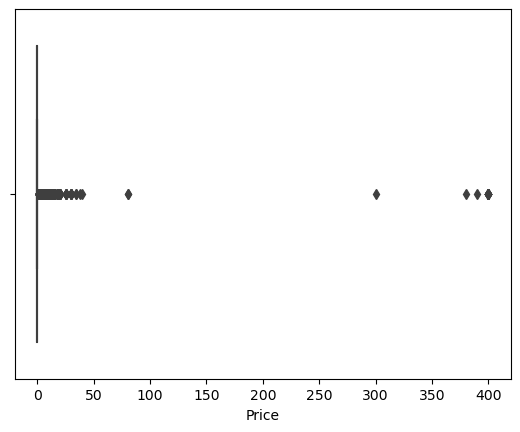

In [28]:
#Are there any outliers? Think about the price of usual apps on the Play Store.
sns.boxplot(inp0.Price)
plt.show()


### Box Plot: Reviews

/Users/michaeldionne/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


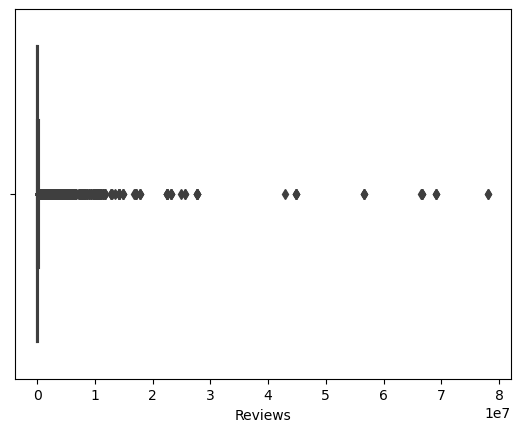

In [29]:
#Are there any apps with very high number of reviews? Do the values seem right?
sns.boxplot(inp0.Reviews)
plt.show()


### Checking Distribution and Skewness:
How are the ratings distributed? Is it more toward higher ratings?

### Distribution of Ratings

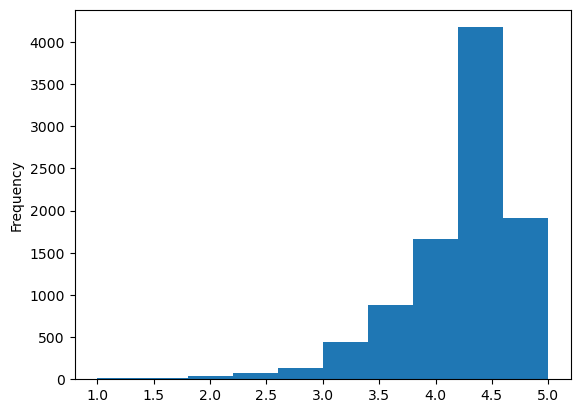

In [30]:
#Distributing the ratings
inp0.Rating.plot.hist()
#Show plot
plt.show()


### Histogram: Size

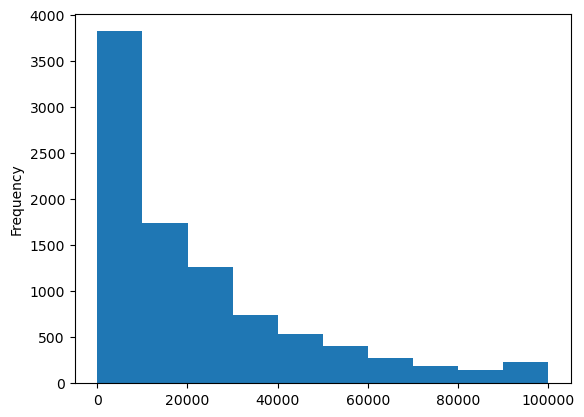

In [31]:
inp0['Size'].plot.hist()
#Show plot
plt.show()


### Observations

A histogram is plotted with ratings on the x-axis and frequency on the y-axis, and the ratings are distributed.

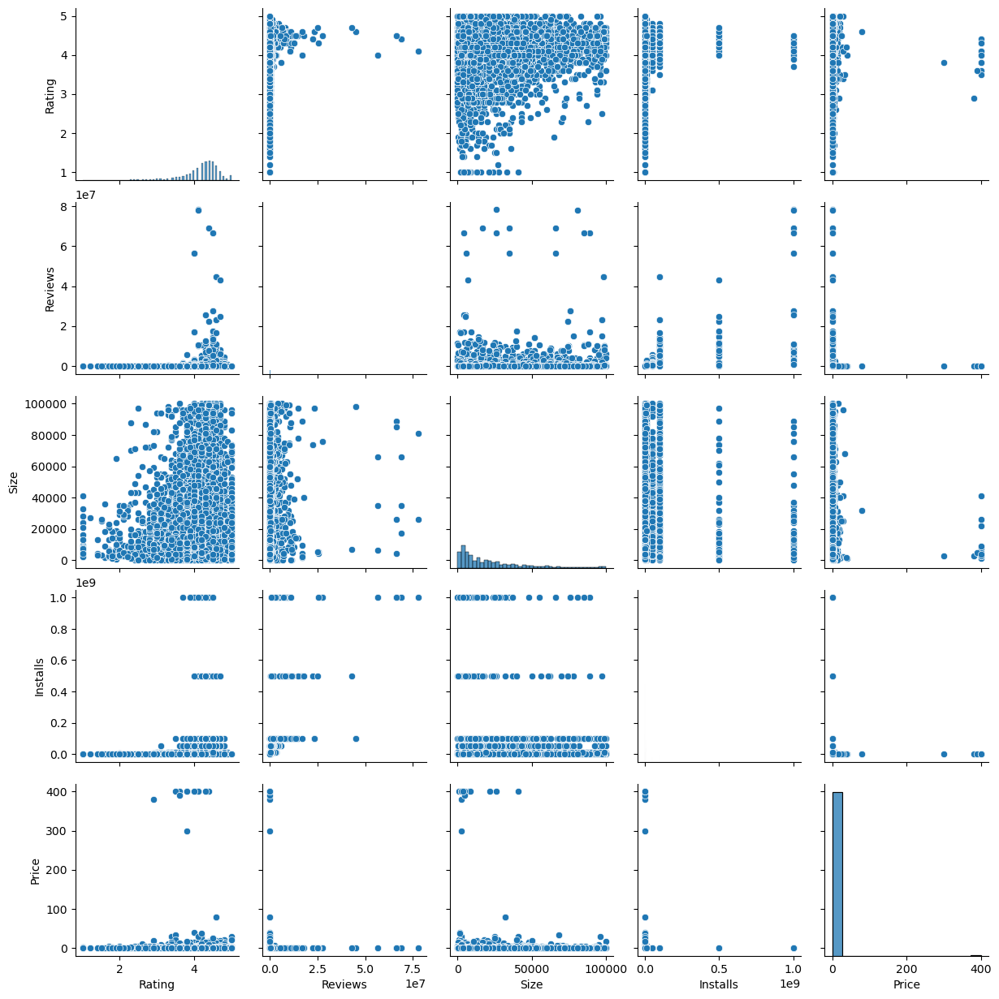

In [32]:
#Pair plot
sns.pairplot(data=inp0)


### Outlier Treatment:
1. Price:
From the box plot, it seems like there are some apps with very high prices. A price of $200 for an application on the Play Store is very high
and suspicious. Check the records that have very high price: Is 200 a high price?

In [33]:
#Checking the records
len(inp0[inp0.Price > 200])


15

In [34]:
inp0[inp0.Price > 200]


,App,Category,Rating,Reviews,Size,Installs,Type,Price,Content_Rating,Genres,Last Updated,Current Ver,Android Ver
4197,most expensive app (H),FAMILY,4.3,6,1500.0,100,Paid,399.99,Everyone,Entertainment,"July 16, 2018",1,7.0 and up
4362,💎 I'm rich,LIFESTYLE,3.8,718,26000.0,10000,Paid,399.99,Everyone,Lifestyle,"March 11, 2018",1.0.0,4.4 and up
4367,I'm Rich - Trump Edition,LIFESTYLE,3.6,275,7300.0,10000,Paid,400.00,Everyone,Lifestyle,"May 3, 2018",1.0.1,4.1 and up
5351,I am rich,LIFESTYLE,3.8,3547,1800.0,100000,Paid,399.99,Everyone,Lifestyle,"January 12, 2018",2,4.0.3 and up
5354,I am Rich Plus,FAMILY,4.0,856,8700.0,10000,Paid,399.99,Everyone,Entertainment,"May 19, 2018",3,4.4 and up
5355,I am rich VIP,LIFESTYLE,3.8,411,2600.0,10000,Paid,299.99,Everyone,Lifestyle,"July 21, 2018",1.1.1,4.3 and up
5356,I Am Rich Premium,FINANCE,4.1,1867,4700.0,50000,Paid,399.99,Everyone,Finance,"November 12, 2017",1.6,4.0 and up
5357,I am extremely Rich,LIFESTYLE,2.9,41,2900.0,1000,Paid,379.99,Everyone,Lifestyle,"July 1, 2018",1,4.0 and up
5358,I am Rich!,FINANCE,3.8,93,22000.0,1000,Paid,399.99,Everyone,Finance,"December 11, 2017",1,4.1 and up
5359,I am rich(premium),FINANCE,3.5,472,965.0,5000,Paid,399.99,Everyone,Finance,"May 1, 2017",3.4,4.4 and up


In [35]:
inp0 = inp0[inp0.Price <= 200].copy()
inp0.shape


(9338, 13)

### 2. Reviews:
Very few apps have very high number of reviews. These are all star apps that don’t help with the analysis and, in fact, will skew it. Drop
records having more than 2 million reviews.

In [36]:
#Dropping the records with more than 2 million reviews
inp0 = inp0[inp0.Reviews <= 2000000]
inp0.shape


(8885, 13)

### 3. Installs:
1. There seem to be some outliers in this field too. Apps having a very high number of installs should be dropped from the analysis. Find out
the different percentiles – 10, 25, 50, 70, 90, 95, 99.
2. Decide a threshold as the cutoff for outliers and drop records having values more than the threshold.

In [37]:
#Dropping the apps that have a very high number of installs
inp0.Installs.quantile([0.1, 0.25, 0.5, 0.70, 0.9, 0.95, 0.99])


0.10         1000.0
0.25        10000.0
0.50       500000.0
0.70      1000000.0
0.90     10000000.0
0.95     10000000.0
0.99    100000000.0
Name: Installs, dtype: float64

### Observations

Looks like there are just 1% of apps having more than 100M installs. These apps might be genuine, but will definitely skew our analysis.
We need to drop these.

In [38]:
#Dropping the apps with more than 100M installs
len(inp0[inp0.Installs >= 1000000000])


6

In [39]:
inp0 = inp0[inp0.Installs < 1000000000].copy()
inp0.shape


(8879, 13)

In [40]:
#Importing warnings
import warnings
warnings.filterwarnings("ignore")


## Bi-variate Analysis:
Let’s look at how the available predictors relate to the variable of interest, i.e., our target variable rating. Make scatter plots (for numeric
features) and box plots (for character features) to assess the relationships between rating and the other features.

1. Make scatter plot/join plot for Rating vs. Price

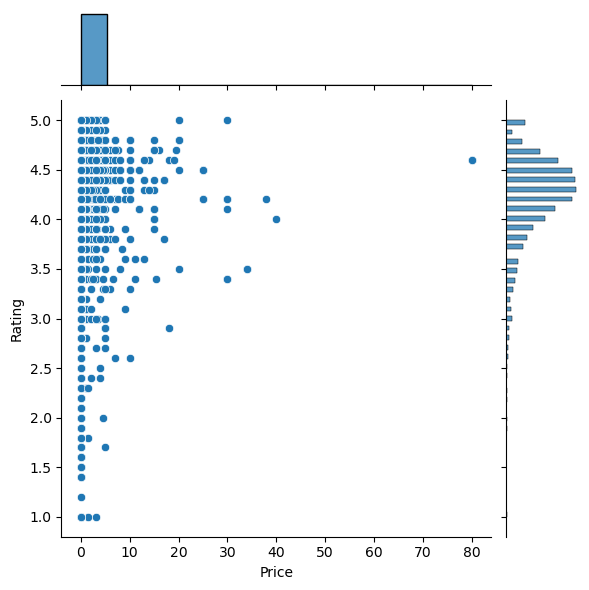

In [41]:
#What pattern do you observe? Does rating increase with price?
sns.jointplot(inp0.Price, inp0.Rating)


2. Make scatter plot/joinplot for Rating vs Size

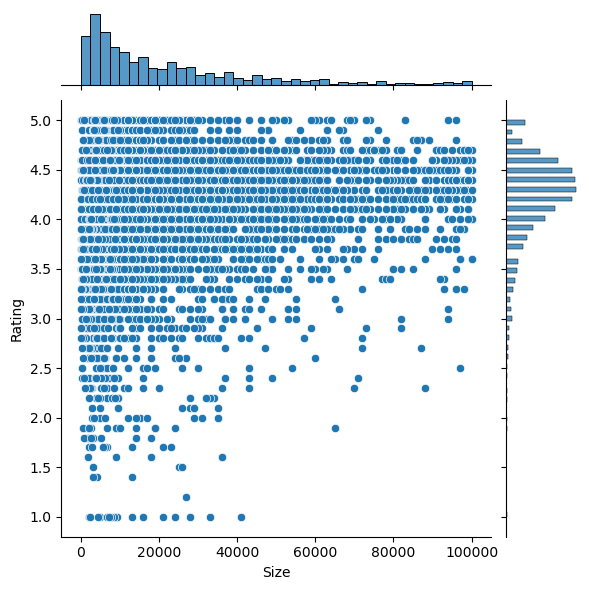

In [42]:
#Are heavier apps rated better?
sns.jointplot(inp0.Size, inp0.Rating)


3. Make scatter plot/joinplot for Rating vs Reviews

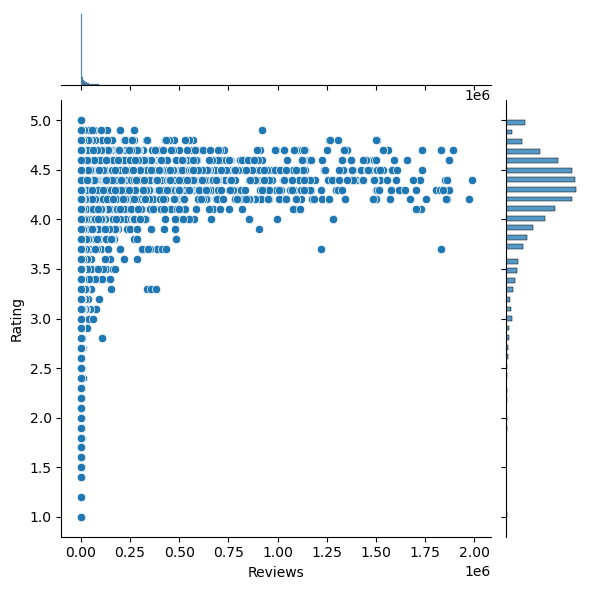

In [43]:
# Does more review mean a better rating always?
sns.jointplot(inp0.Reviews, inp0.Rating)


4. Make boxplot for Rating vs Content Rating

<AxesSubplot:xlabel='Content_Rating', ylabel='Rating'>

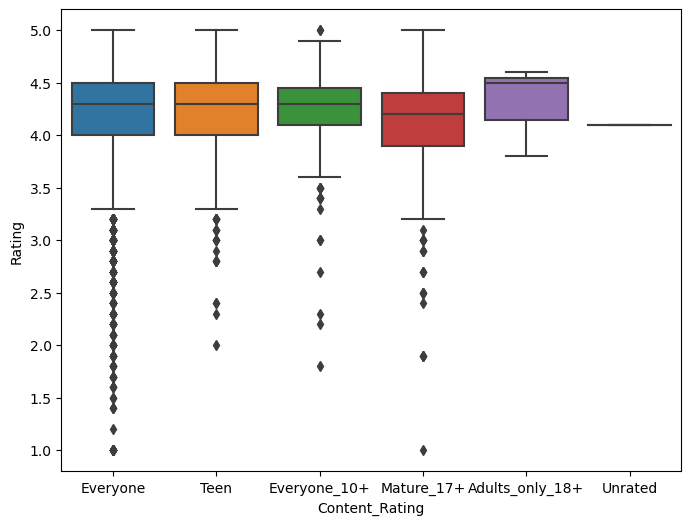

In [44]:
#Is there any difference in the ratings? Are some types liked better?
plt.figure(figsize=[8,6])
sns.boxplot(inp0['Content_Rating'], inp0.Rating)


5. Make boxplot for Ratings vs. Category

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]),
 [Text(0, 0, 'ART_AND_DESIGN'),
  Text(1, 0, 'AUTO_AND_VEHICLES'),
  Text(2, 0, 'BEAUTY'),
  Text(3, 0, 'BOOKS_AND_REFERENCE'),
  Text(4, 0, 'BUSINESS'),
  Text(5, 0, 'COMICS'),
  Text(6, 0, 'COMMUNICATION'),
  Text(7, 0, 'DATING'),
  Text(8, 0, 'EDUCATION'),
  Text(9, 0, 'ENTERTAINMENT'),
  Text(10, 0, 'EVENTS'),
  Text(11, 0, 'FINANCE'),
  Text(12, 0, 'FOOD_AND_DRINK'),
  Text(13, 0, 'HEALTH_AND_FITNESS'),
  Text(14, 0, 'HOUSE_AND_HOME'),
  Text(15, 0, 'LIBRARIES_AND_DEMO'),
  Text(16, 0, 'LIFESTYLE'),
  Text(17, 0, 'GAME'),
  Text(18, 0, 'FAMILY'),
  Text(19, 0, 'MEDICAL'),
  Text(20, 0, 'SOCIAL'),
  Text(21, 0, 'SHOPPING'),
  Text(22, 0, 'PHOTOGRAPHY'),
  Text(23, 0, 'SPORTS'),
  Text(24, 0, 'TRAVEL_AND_LOCAL'),
  Text(25, 0, 'TOOLS'),
  Text(26, 0, 'PERSONALIZATION'),
  Text(27, 0, 'PRODUCTIVITY'),
  Text(28, 0, 'PARENTING'),
  Text(

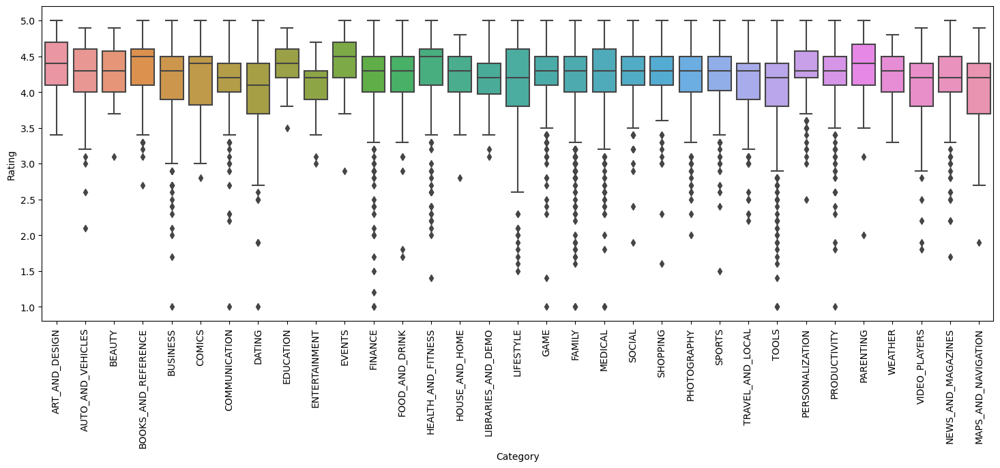

In [45]:
#Which genre has the best ratings?
plt.figure(figsize=[18,6])
g = sns.boxplot(inp0.Category, inp0.Rating)
plt.xticks(rotation=90)


### Pre-processing the Dataset

1. Make a copy of the dataset

In [46]:
#Making a copy
inp1 = inp0.copy()


2. Apply log transformation (np.log1p) to Reviews and Installs

Reviews and Installs have some values that are still relatively very high. Before building a linear regression model, you need to reduce the skew.

In [47]:
#Reducing the skew
inp0.Installs.describe()


count    8.879000e+03
mean     5.595862e+06
std      2.421042e+07
min      5.000000e+00
25%      1.000000e+04
50%      5.000000e+05
75%      5.000000e+06
max      5.000000e+08
Name: Installs, dtype: float64

In [48]:
inp1.Installs = inp1.Installs.apply(np.log1p)


In [49]:
inp1.Reviews = inp1.Reviews.apply(np.log1p)


3. Drop columns App, Last Updated, Current Ver, and Android Ver
These variables are not useful for our task.

In [50]:
inp1.dtypes


App                object
Category           object
Rating            float64
Reviews           float64
Size              float64
Installs          float64
Type               object
Price             float64
Content_Rating     object
Genres             object
Last Updated       object
Current Ver        object
Android Ver        object
dtype: object

In [51]:
#Dropping the variables that are not useful for our task
inp1.drop(["App", "Last Updated", "Current Ver", "Android Ver"], axis=1, inplace=True)
inp1.shape



(8879, 9)

4. Dummy Columns:

Get dummy columns for Category, Genres, and Content Rating. This needs to be done as the models do not understand categorical data,
and all data should be numeric. Dummy encoding is one way to convert character fields to numeric fields. Name of the dataframe should
be inp2.

In [52]:
inp2 = pd.get_dummies(inp1, drop_first=True)


In [53]:
inp2.columns


Index(['Rating', 'Reviews', 'Size', 'Installs', 'Price',
       'Category_AUTO_AND_VEHICLES', 'Category_BEAUTY',
       'Category_BOOKS_AND_REFERENCE', 'Category_BUSINESS', 'Category_COMICS',
       ...
       'Genres_Tools', 'Genres_Tools_Education', 'Genres_Travel_&_Local',
       'Genres_Travel_&_Local_Action_&_Adventure', 'Genres_Trivia',
       'Genres_Video_Players_&_Editors',
       'Genres_Video_Players_&_Editors_Creativity',
       'Genres_Video_Players_&_Editors_Music_&_Video', 'Genres_Weather',
       'Genres_Word'],
      dtype='object', length=157)

In [54]:
inp2.shape


(8879, 157)

## Train-test split

Let us distribute the data into training and test datasets using the train_test_split() function.

In [55]:
from sklearn.model_selection import train_test_split


In [56]:
#train_test_split
df_train, df_test = train_test_split(inp2, train_size = 0.7, random_state = 100)


In [57]:
df_train.shape, df_test.shape


((6215, 157), (2664, 157))

Let us separate the dataframes into X_train, y_train, X_test, y_test.

In [58]:
y_train = df_train.pop("Rating")
X_train = df_train


In [59]:
X_train.head(1)


,Reviews,Size,Installs,Price,Category_AUTO_AND_VEHICLES,Category_BEAUTY,Category_BOOKS_AND_REFERENCE,Category_BUSINESS,Category_COMICS,Category_COMMUNICATION,...,Genres_Tools,Genres_Tools_Education,Genres_Travel_&_Local,Genres_Travel_&_Local_Action_&_Adventure,Genres_Trivia,Genres_Video_Players_&_Editors,Genres_Video_Players_&_Editors_Creativity,Genres_Video_Players_&_Editors_Music_&_Video,Genres_Weather,Genres_Word
1279,7.63627,6900.0,11.512935,0.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [60]:
y_test = df_test.pop("Rating")
X_test = df_test


In [61]:
X_test.head(1)


,Reviews,Size,Installs,Price,Category_AUTO_AND_VEHICLES,Category_BEAUTY,Category_BOOKS_AND_REFERENCE,Category_BUSINESS,Category_COMICS,Category_COMMUNICATION,...,Genres_Tools,Genres_Tools_Education,Genres_Travel_&_Local,Genres_Travel_&_Local_Action_&_Adventure,Genres_Trivia,Genres_Video_Players_&_Editors,Genres_Video_Players_&_Editors_Creativity,Genres_Video_Players_&_Editors_Music_&_Video,Genres_Weather,Genres_Word
1161,9.329456,24000.0,13.815512,0.0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


## **Regression Algorithms:**
Note: Let us take a look at the theory part before moving on to the training and prediction.

Types of Regression Algorithms:
1. Linear regression
2. Multiple linear regression
3. Polynomial regression
4. Ridge regression
5. Lasso regression
6. ElasticNet regression

#### When to use regression?
If target variable is a continuous numeric variable (100–2000), then use a regression algorithm.

1. Linear Regression:

    Linear Regression is a statistical model used to predict the relationship between independent and dependent variables denoted by x and y respectively.

2. Multiple Linear Regression:
    
    Multiple linear regression is a statistical technique used to predict the outcome of a response variable through several explanatory variables and model the relationships between them.

3. Polynomial Regression:
    Polynomial regression is applied when data is not formed in a straight line. It is used to fit a linear model to non-linear data by creating
    new features from powers of non-linear features.

#### Types of Model Evaluation Metrics:

1. Sum of Squares Total (SST)
    The squared variations between the measured dependent variable and its mean are referred to as the Sum of Squares Total (SST) or Total
    Sum of Squares (TSS).
    
    a. It's similar to the variation of descriptive statistics in that it's  the    dispersion of measured variables around the mean.
    
    b. It is a measure of the dataset's overall variability.

2. Sum of Squares due to Regression (SSR)
    The difference between the predicted value and the dependent variable's mean are referred to as the Sum of Squares due to Regression (SSR) or Explained Sum of Squares (ESS).

    It can be considered as a metric for describing how well our line fits the data.
    
    If the SSR (or ESS) is equal to the SST (or TSS), the regression model is flawless and captures all observed variability.

    #### Measures the explained variability by your line.
    

3. Sum of Squares Error (SSE)

    The difference between the observed and predicted values are referred to as the Sum of Squares Error (SSE) or Residual Sum of Squares
    (RSS), where residual stands for remaining or unexplained .
    
    This error must be reduced since the smaller it is, the better the regression's estimation power.

    #### Measures the unexplained variability by the regression.

#### Relation Among SST, SSR, and SSE
1. Since certain people use these abbreviations in various ways, it can be very confusing.
2. We use one of two sets of notations for these abbreviations: SST, SSR, and SSE or TSS, ESS, and RSS.
3. These equations are related in the following ways:
    This is because the overall variability of the dataset is equivalent to the variability described by the regression line and the unknown
    variability (also known as error).
4. For a constant total variability, a lower error would result in a better regression. A higher error, on the other hand, would result in a weaker
regression. This should always be remembered regardless of the notation set used.

### Total variability = Explained variability + Unexplained variability

#### R-Square Matrix
1. The determination coefficient also known as R2 (R-squared) score is used for the performance evaluation of a linear regression model.
2. R2 displays the proportion of data points inside the regression equation line.
3. A higher R2 value means improved results.
4. The highest possible score is 1, which is achieved when the predicted and actual values are the same.
5. The R2 score is 0 for a baseline model.
6. In the worst-case scenario, the R2 score can also be negative.

In [62]:
#Importing the statsmodel library
import statsmodels.api as sm
import statsmodels.formula.api as smf


In [63]:
#Applying linear regression
model1 = sm.OLS(y_train, X_train)


In [65]:
#Finding the summary
model1.summary()

AttributeError: 'OLS' object has no attribute 'summary'